In [89]:
import numpy as np
from nptdms import TdmsFile
import matplotlib.pyplot as plt
import matplotlib.patches as patches

import soundfile as sf

from pathlib import Path

In [90]:
import scipy
import pandas as pd
import librosa
import warnings
import os

In [91]:
import sys

# append the path of the
# parent directory
sys.path.append('..')
sys.path.append('../src/')
sys.path.append('../src/models/bat_call_detector/batdetect2/')

import src.batdt2_pipeline as batdetect2_pipeline
import src.file_dealer as file_dealer
from bat_detect.detector import models
from cfg import get_config
from pipeline import pipeline
from utils.utils import gen_empty_df, convert_df_ravenpro
from bat_detect.utils import wavfile
import bat_detect.utils.detector_utils as du
import bat_detect.detector.compute_features as feats
import bat_detect.detector.post_process as pp

In [92]:
cfg = get_config()
cfg['tmp_dir'] = Path('../output/tmp')
cfg['output_dir'] = Path('../output_dir/mic_array_test_20240830/')
cfg['run_model'] = True
cfg['should_csv'] = True
cfg['save'] = True

In [93]:
def run_pipeline_on_file(file, cfg):
    bd_preds = pd.DataFrame()

    if not cfg['output_dir'].is_dir():
        cfg['output_dir'].mkdir(parents=True, exist_ok=True)
    if not cfg['tmp_dir'].is_dir():
        cfg['tmp_dir'].mkdir(parents=True, exist_ok=True)


    if (cfg['run_model']):
        cfg["csv_filename"] = f"batdetect2_pipeline_{file.name.split('.')[0]}"
        filepath = (cfg['output_dir'] / f'{cfg["csv_filename"]}.csv')
        if not(filepath.is_file()):
            print(f"Generating detections for {file.name}")
            segmented_file_paths = batdetect2_pipeline.generate_segmented_paths([file], cfg)
            file_path_mappings = batdetect2_pipeline.initialize_mappings(segmented_file_paths, cfg)
            bd_preds = batdetect2_pipeline.run_models(file_path_mappings)
            if cfg['save']:
                batdetect2_pipeline._save_predictions(bd_preds, cfg['output_dir'], cfg)
            batdetect2_pipeline.delete_segments(segmented_file_paths)
        else:
            bd_preds = pd.read_csv(filepath)

    return bd_preds

In [94]:
def plot_audio_seg(audio_features, spec_features):
    audio_seg = audio_features['audio_seg']
    fs = audio_features['sample_rate']
    start = audio_features['start']
    duration = audio_features['duration']

    vmax = spec_features['vmax']
    vmin = spec_features['vmin']
    cmap = spec_features['cmap']
    nfft = spec_features['NFFT']

    plt.figure(figsize=(15, 5))
    plt.rcParams.update({'font.size': 24})
    plt.title(spec_features['plot_title'], fontsize=24)
    # plt.specgram(audio_seg, NFFT=nfft, cmap=cmap)
    plt.specgram(audio_seg, NFFT=nfft, cmap=cmap, vmin=vmin, vmax=vmax)
    plt.yticks(ticks=np.linspace(0, 1, 6), labels=np.linspace(0, fs/2000, 6).astype('int'))
    plot_xtype = 'float'
    if (duration > 60):
        plot_xtype = 'int'
    plt.xticks(ticks=np.linspace(0, duration*(fs/2), 11), 
               labels=np.round(np.linspace(start, start+duration, 11, dtype=plot_xtype), 2), rotation=30)
    plt.ylabel("Frequency (kHz)")
    plt.xlabel("Time (s)")
    plt.show()

FREQ_COLORS = {'LF':'cyan',
               'HF':'orange'}

def plot_colored_dets_over_audio(audio_features, spec_features, plot_dets):
    audio_seg = audio_features['audio_seg']
    fs = audio_features['sample_rate']
    start = audio_features['start']
    duration = audio_features['duration']

    vmax = spec_features['vmax']
    vmin = spec_features['vmin']
    cmap = spec_features['cmap']
    nfft = spec_features['NFFT']

    plt.figure(figsize=(15, 5))
    plt.rcParams.update({'font.size': 24})
    plt.title(spec_features['plot_title'], fontsize=24)
    plt.specgram(audio_seg, NFFT=nfft, cmap=cmap, vmin=vmin, vmax=vmax)

    ax = plt.gca()
    for i, row in plot_dets.iterrows():
        rect = patches.Rectangle(((row['start_time'] - start)*(fs/2), row['low_freq']/(fs/2)), 
                        (row['end_time'] - row['start_time'])*(fs/2), (row['high_freq'] - row['low_freq'])/(fs/2), 
                        linewidth=2, edgecolor=FREQ_COLORS[row['KMEANS_CLASSES']], facecolor='none', alpha=0.8)
        ax.add_patch(rect)

    plt.yticks(ticks=np.linspace(0, 1, 6), labels=np.linspace(0, fs/2000, 6).astype('int'))
    plot_xtype = 'float'
    if (duration > 60):
        plot_xtype = 'int'
    plt.xticks(ticks=np.linspace(0, duration*(fs/2), 11), 
               labels=np.round(np.linspace(start, start+duration, 11, dtype=plot_xtype), 2), rotation=30)
    plt.ylabel("Frequency (kHz)")
    plt.xlabel("Time (s)")
    plt.show()

In [ ]:
files_from_loc = sorted(list(Path('/Users/adityakrishna/Downloads/array_test_20240830_mic/').glob(pattern='in_field*.tdms')))
files_from_loc

In [ ]:
for file in files_from_loc[:3]:
    tdms_file = TdmsFile.read(file)
    group_name = tdms_file.groups()[0].name
    group = tdms_file[group_name]
    channel_name = group.channels()[0].name
    channel = group[channel_name]

    fs = 100e3
    start = 0
    duration = 10
    for start in np.arange(0, (len(channel[:])/fs), 10):
        audio_seg = channel[int(fs*start):int(fs*(start+duration))]
        vmax = 0
        vmin = -60
        cmap = 'jet'
        nfft = 1024

        plt.figure(figsize=(15, 5))
        plt.rcParams.update({'font.size': 24})
        plt.title(file.name, fontsize=24)
        # plt.specgram(audio_seg, NFFT=nfft, cmap=cmap)
        plt.specgram(audio_seg, NFFT=nfft, cmap=cmap, vmin=vmin, vmax=vmax)
        plt.yticks(ticks=np.linspace(0, 1, 6), labels=np.linspace(0, fs/2000, 6).astype('int'))
        plot_xtype = 'float'
        if (duration > 60):
            plot_xtype = 'int'
        plt.xticks(ticks=np.linspace(0, duration*(fs/2), 11), 
                    labels=np.round(np.linspace(start, start+duration, 11, dtype=plot_xtype), 2), rotation=30)
        plt.ylabel("Frequency (kHz)")
        plt.xlabel("Time (s)")
        plt.show()

In [ ]:
for file in files_from_loc[3:]:
    tdms_file = TdmsFile.read(file)
    group_name = tdms_file.groups()[0].name
    group = tdms_file[group_name]
    channel_name = group.channels()[0].name
    channel = group[channel_name]

    fs = 200e3
    start = 0
    duration = 10
    for start in np.arange(0, (len(channel[:])/fs), 10):
        audio_seg = channel[int(fs*start):int(fs*(start+duration))]
        vmax = 0
        vmin = -60
        cmap = 'jet'
        nfft = 1024

        plt.figure(figsize=(15, 5))
        plt.rcParams.update({'font.size': 24})
        plt.title(file.name, fontsize=24)
        # plt.specgram(audio_seg, NFFT=nfft, cmap=cmap)
        plt.specgram(audio_seg, NFFT=nfft, cmap=cmap, vmin=vmin, vmax=vmax)
        plt.yticks(ticks=np.linspace(0, 1, 6), labels=np.linspace(0, fs/2000, 6).astype('int'))
        plot_xtype = 'float'
        if (duration > 60):
            plot_xtype = 'int'
        plt.xticks(ticks=np.linspace(0, duration*(fs/2), 11), 
                    labels=np.round(np.linspace(start, start+duration, 11, dtype=plot_xtype), 2), rotation=30)
        plt.ylabel("Frequency (kHz)")
        plt.xlabel("Time (s)")
        plt.show()

In [ ]:
files_from_loc = sorted(list(Path('/Users/adityakrishna/Downloads/array_test_20240830_mic/').glob(pattern='in_carp*.tdms')))
files_from_loc

In [ ]:
for file in files_from_loc:
    tdms_file = TdmsFile.read(file)
    group_name = tdms_file.groups()[0].name
    group = tdms_file[group_name]
    channel_name = group.channels()[0].name
    channel = group[channel_name]

    fs = 200e3
    start = 0
    duration = 10
    for start in np.arange(0, (len(channel[:])/fs), 10):
        audio_seg = channel[int(fs*start):int(fs*(start+duration))]
        vmax = 0
        vmin = -60
        cmap = 'jet'
        nfft = 1024

        plt.figure(figsize=(15, 5))
        plt.rcParams.update({'font.size': 24})
        plt.title(file.name, fontsize=24)
        # plt.specgram(audio_seg, NFFT=nfft, cmap=cmap)
        plt.specgram(audio_seg, NFFT=nfft, cmap=cmap, vmin=vmin, vmax=vmax)
        plt.yticks(ticks=np.linspace(0, 1, 6), labels=np.linspace(0, fs/2000, 6).astype('int'))
        plot_xtype = 'float'
        if (duration > 60):
            plot_xtype = 'int'
        plt.xticks(ticks=np.linspace(0, duration*(fs/2), 11), 
                    labels=np.round(np.linspace(start, start+duration, 11, dtype=plot_xtype), 2), rotation=30)
        plt.ylabel("Frequency (kHz)")
        plt.xlabel("Time (s)")
        plt.show()

In [ ]:
files_from_loc = sorted(list(Path('/Users/adityakrishna/Downloads/array_test_20240830_mic/').glob(pattern='in_field*.tdms')))
files_from_loc[6]

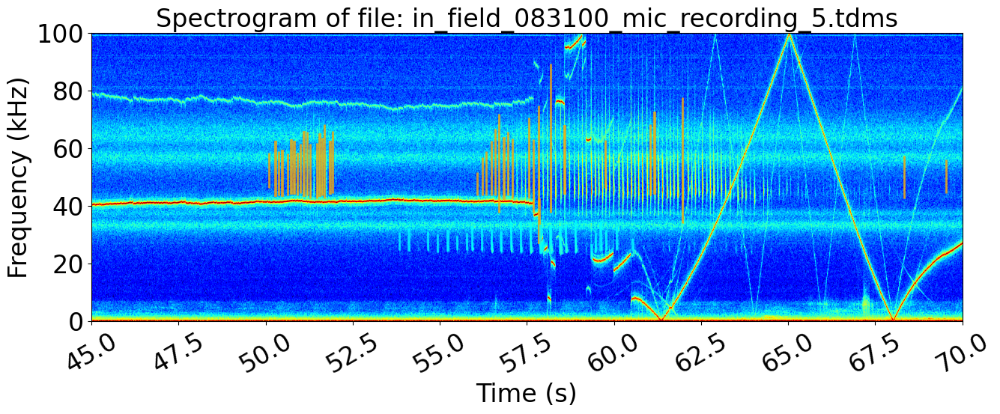

In [95]:
files_from_loc = sorted(list(Path('/Users/adityakrishna/Downloads/array_test_20240830_mic/').glob(pattern='in_field*.tdms')))
file = files_from_loc[6]
tdms_file = TdmsFile.read(file)
group_name = tdms_file.groups()[0].name
group = tdms_file[group_name]
channel_name = group.channels()[0].name
channel = group[channel_name]
fs = 200000

write_file = Path(f'../../Downloads/{file.name}_sample.WAV')
sf.write(write_file, channel[:], fs)
cfg['input_audio'] = Path(write_file)
dets = run_pipeline_on_file(write_file, cfg)
Path(write_file).unlink()

start = 45
duration = 25
# for start in np.arange(0, (len(channel[:])/fs), 10):
audio_seg = channel[int(fs*start):int(fs*(start+duration))]
lower_dB = -58
upper_dB = 0
vmin = lower_dB # hide anything below lower_dB dB
vmax = upper_dB # hide anything above upper_dB dB
audio_features = dict()
audio_features['file_path'] = Path(file)
audio_features['audio_seg'] = audio_seg
audio_features['sample_rate'] = fs
audio_features['start'] = start
audio_features['duration'] = duration

spec_features = dict()
spec_features['NFFT'] = 1024 # When segments are short, NFFT should also be small to best see calls (must always be > 128)
spec_features['cmap'] = 'jet' # This colormap shows best contrast between noise and signals
spec_features['vmin'] = vmin
spec_features['vmax'] = vmax

spec_features['plot_title'] = f"Spectrogram of file: {audio_features['file_path'].name}"
plot_dets = dets.loc[(dets['start_time']>=start)&(dets['end_time']<=(start+duration))]
plot_dets = plot_dets.sort_values(by='start_time')
plot_dets.reset_index(drop=True, inplace=True)
plot_colored_dets_over_audio(audio_features, spec_features, plot_dets)
# plot_audio_seg(audio_features, spec_features)

In [96]:
def get_snr_from_band_limited_signal(snr_call_signal, snr_noise_signal): 

    signal_power_rms = np.sqrt(np.square(snr_call_signal).mean())
    noise_power_rms = np.sqrt(np.square(snr_noise_signal).mean())
    snr = abs(20 * np.log10(signal_power_rms / noise_power_rms))

    return snr


def bandpass_audio_signal(audio_seg, fs, low_freq_cutoff, high_freq_cutoff):
    nyq = fs // 2
    low_cutoff = (low_freq_cutoff) / nyq
    high_cutoff =  (high_freq_cutoff) / nyq
    b, a = scipy.signal.butter(4, [low_cutoff, high_cutoff], btype='band', analog=False)
    band_limited_audio_seg = scipy.signal.filtfilt(b, a, audio_seg)

    return band_limited_audio_seg

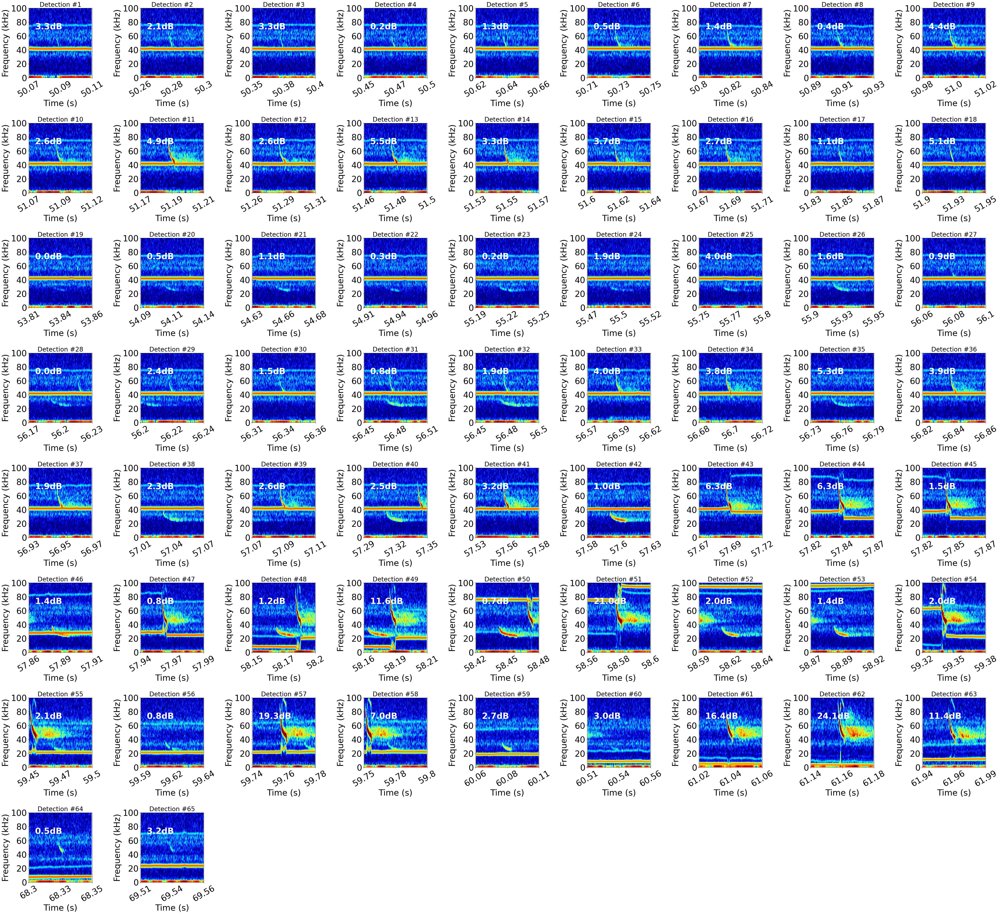

In [98]:
files_from_loc = sorted(list(Path('/Users/adityakrishna/Downloads/array_test_20240830_mic/').glob(pattern='in_field*.tdms')))
file = files_from_loc[6]
tdms_file = TdmsFile.read(file)
group_name = tdms_file.groups()[0].name
group = tdms_file[group_name]
channel_name = group.channels()[0].name
channel = group[channel_name]
fs = 200000

# start = 45
plt.figure(figsize=(6*np.ceil(len(plot_dets)**0.5), 6*np.ceil(len(plot_dets)**0.5)))
plt.rcParams.update({'font.size': 32})
for i, row in plot_dets.iterrows():
    start = row['start_time'] - 0.020
    call_dur = (row['end_time'] - row['start_time'])
    duration = call_dur + 0.040

    call_sig = channel[int(fs*row['start_time']):int(fs*(row['end_time']))]
    # band_limited_call_sig = bandpass_audio_signal(call_sig, fs, row['low_freq']-2000, row['high_freq']+2000)
    noise_sig = channel[int(fs*(row['start_time'] - call_dur)):int(fs*row['start_time'])]
    # band_limited_noise_sig = bandpass_audio_signal(noise_sig, fs, row['low_freq']-2000, row['high_freq']+2000)
    snr = get_snr_from_band_limited_signal(call_sig, noise_sig)

    audio_seg = channel[int(fs*start):int(fs*(start + duration))]
    lower_dB = -50
    upper_dB = 0
    vmin = lower_dB # hide anything below lower_dB dB
    vmax = upper_dB # hide anything above upper_dB dB
    cmap = 'jet'
    nfft = 132

    plt.subplot(int(np.ceil(len(plot_dets)**0.5)), int(np.ceil(len(plot_dets)**0.5)), i+1)
    plt.title(f'Detection #{i+1}', fontsize=24)
    plt.specgram(audio_seg, NFFT=nfft, cmap=cmap, vmin=vmin, vmax=vmax)
    ax = plt.gca()
    plt.text(x=0.1, y=0.7, s=f'{round(snr,1)}dB', fontweight='bold', color='w', transform=ax.transAxes)
    plt.yticks(ticks=np.linspace(0, 1, 6), labels=np.linspace(0, fs/2000, 6).astype('int'))
    plot_xtype = 'float'
    if (duration > 60):
        plot_xtype = 'int'
    plt.xticks(ticks=np.linspace(0, duration*(fs/2), 3), 
               labels=np.round(np.linspace(start, start+duration, 3, dtype=plot_xtype), 2), rotation=30)
    plt.ylabel("Frequency (kHz)")
    plt.xlabel("Time (s)")

plt.tight_layout()
plt.show()

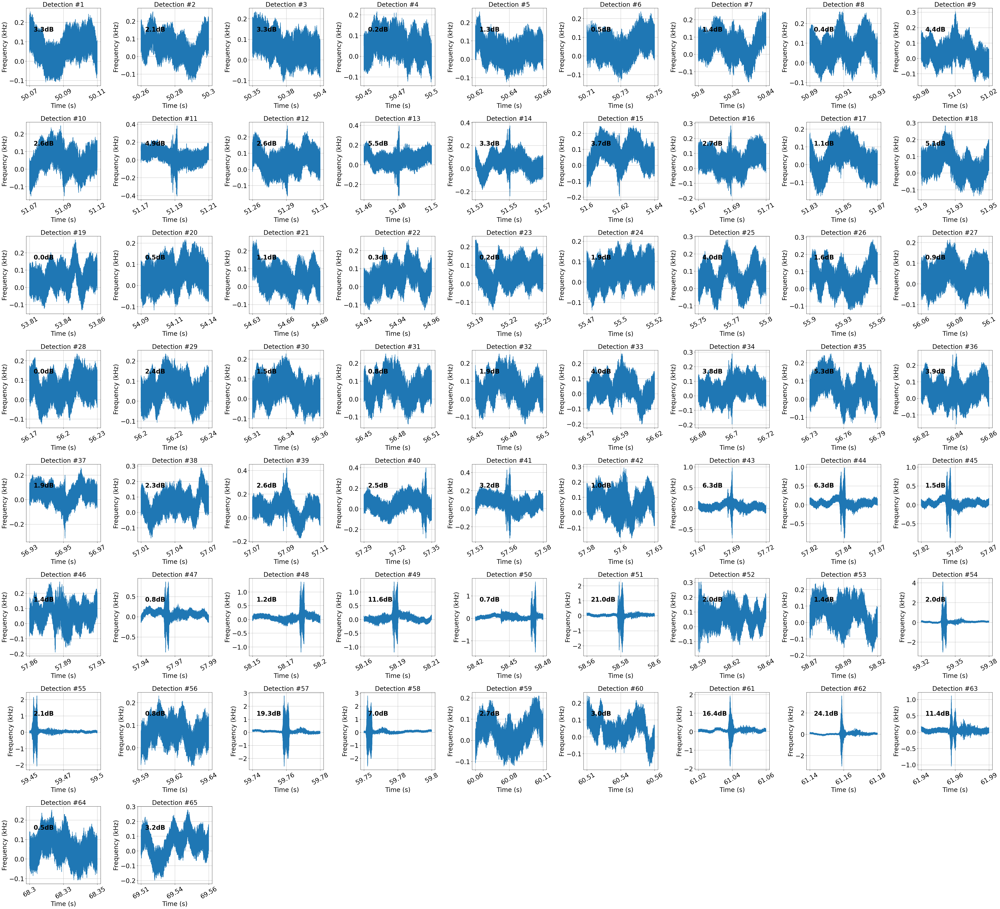

In [99]:
files_from_loc = sorted(list(Path('/Users/adityakrishna/Downloads/array_test_20240830_mic/').glob(pattern='in_field*.tdms')))
file = files_from_loc[6]
tdms_file = TdmsFile.read(file)
group_name = tdms_file.groups()[0].name
group = tdms_file[group_name]
channel_name = group.channels()[0].name
channel = group[channel_name]
fs = 200000

# start = 45
plt.figure(figsize=(6*np.ceil(len(plot_dets)**0.5), 6*np.ceil(len(plot_dets)**0.5)))
plt.rcParams.update({'font.size': 24})
for i, row in plot_dets.iterrows():
    start = row['start_time'] - 0.020
    call_dur = (row['end_time'] - row['start_time'])
    duration = call_dur + 0.040

    call_sig = channel[int(fs*row['start_time']):int(fs*(row['end_time']))]
    # band_limited_call_sig = bandpass_audio_signal(call_sig, fs, row['low_freq']-2000, row['high_freq']+2000)
    noise_sig = channel[int(fs*(row['start_time'] - call_dur)):int(fs*row['start_time'])]
    # band_limited_noise_sig = bandpass_audio_signal(noise_sig, fs, row['low_freq']-2000, row['high_freq']+2000)
    snr = get_snr_from_band_limited_signal(call_sig, noise_sig)

    audio_seg = channel[int(fs*start):int(fs*(start + duration))]
    lower_dB = -58
    upper_dB = 0
    vmin = lower_dB # hide anything below lower_dB dB
    vmax = upper_dB # hide anything above upper_dB dB
    cmap = 'jet'
    nfft = 132

    plt.subplot(int(np.ceil(len(plot_dets)**0.5)), int(np.ceil(len(plot_dets)**0.5)), i+1)
    plt.title(f'Detection #{i+1}', fontsize=24)
    plt.plot(audio_seg)
    ax = plt.gca()
    plt.text(x=0.1, y=0.7, s=f'{round(snr,1)}dB', fontweight='bold', color='k', transform=ax.transAxes)
    plot_xtype = 'float'
    if (duration > 60):
        plot_xtype = 'int'
    plt.grid(which='both')
    plt.xticks(ticks=np.linspace(0, duration*(fs), 3), 
               labels=np.round(np.linspace(start, start+duration, 3, dtype=plot_xtype), 2), rotation=30)
    plt.ylabel("Frequency (kHz)")
    plt.xlabel("Time (s)")

plt.tight_layout()
plt.show()

In [100]:
files_from_loc = sorted(list(Path('/Users/adityakrishna/Downloads/array_test_20240830_micromoth/').glob(pattern='20240830_21*.WAV')))
files_from_loc

[PosixPath('/Users/adityakrishna/Downloads/array_test_20240830_micromoth/20240830_210000.WAV'),
 PosixPath('/Users/adityakrishna/Downloads/array_test_20240830_micromoth/20240830_210100.WAV'),
 PosixPath('/Users/adityakrishna/Downloads/array_test_20240830_micromoth/20240830_210200.WAV'),
 PosixPath('/Users/adityakrishna/Downloads/array_test_20240830_micromoth/20240830_210300.WAV'),
 PosixPath('/Users/adityakrishna/Downloads/array_test_20240830_micromoth/20240830_210400.WAV'),
 PosixPath('/Users/adityakrishna/Downloads/array_test_20240830_micromoth/20240830_210500.WAV'),
 PosixPath('/Users/adityakrishna/Downloads/array_test_20240830_micromoth/20240830_210600.WAV'),
 PosixPath('/Users/adityakrishna/Downloads/array_test_20240830_micromoth/20240830_210700.WAV'),
 PosixPath('/Users/adityakrishna/Downloads/array_test_20240830_micromoth/20240830_210800.WAV'),
 PosixPath('/Users/adityakrishna/Downloads/array_test_20240830_micromoth/20240830_210900.WAV'),
 PosixPath('/Users/adityakrishna/Downloa

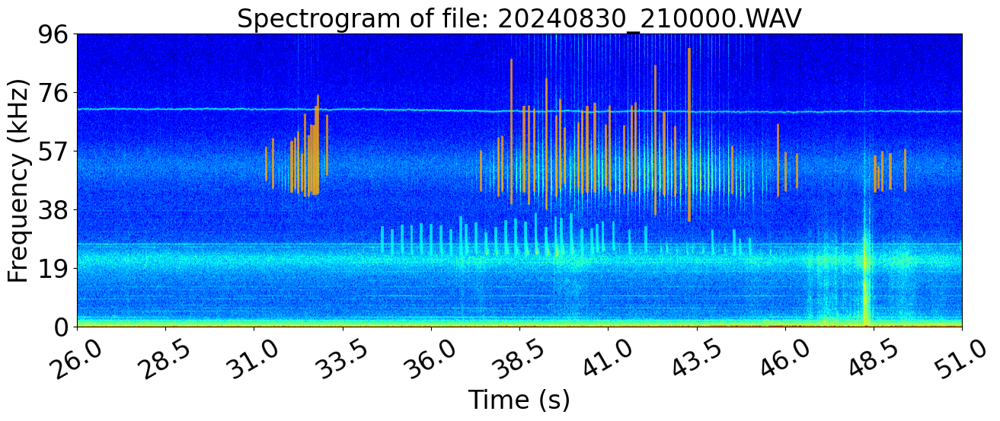

In [101]:
files_from_loc = sorted(list(Path('/Users/adityakrishna/Downloads/array_test_20240830_micromoth/').glob(pattern='20240830_21*.WAV')))
file = files_from_loc[0]
cfg['input_audio'] = Path(file)
dets = run_pipeline_on_file(file, cfg)
recorded_audio = sf.SoundFile(file)
start = 26
fs = recorded_audio.samplerate
recorded_audio.seek(int(fs*start))
duration = 25
audio_seg = recorded_audio.read(int(fs*duration))
lower_dB = -70
upper_dB = 0
vmin = lower_dB # hide anything below lower_dB dB
vmax = upper_dB # hide anything above upper_dB dB
audio_features = dict()
audio_features['file_path'] = Path(file)
audio_features['audio_seg'] = audio_seg
audio_features['sample_rate'] = fs
audio_features['start'] = start
audio_features['duration'] = duration

spec_features = dict()
spec_features['NFFT'] = 1024 # When segments are short, NFFT should also be small to best see calls (must always be > 128)
spec_features['cmap'] = 'jet' # This colormap shows best contrast between noise and signals
spec_features['vmin'] = vmin
spec_features['vmax'] = vmax

spec_features['plot_title'] = f"Spectrogram of file: {audio_features['file_path'].name}"
plot_dets = dets.loc[(dets['start_time']>=start)&(dets['end_time']<=(start+duration))]
plot_dets = plot_dets.sort_values(by='start_time')
plot_dets.reset_index(drop=True, inplace=True)
plot_colored_dets_over_audio(audio_features, spec_features, plot_dets)
# plot_audio_seg(audio_features, spec_features)

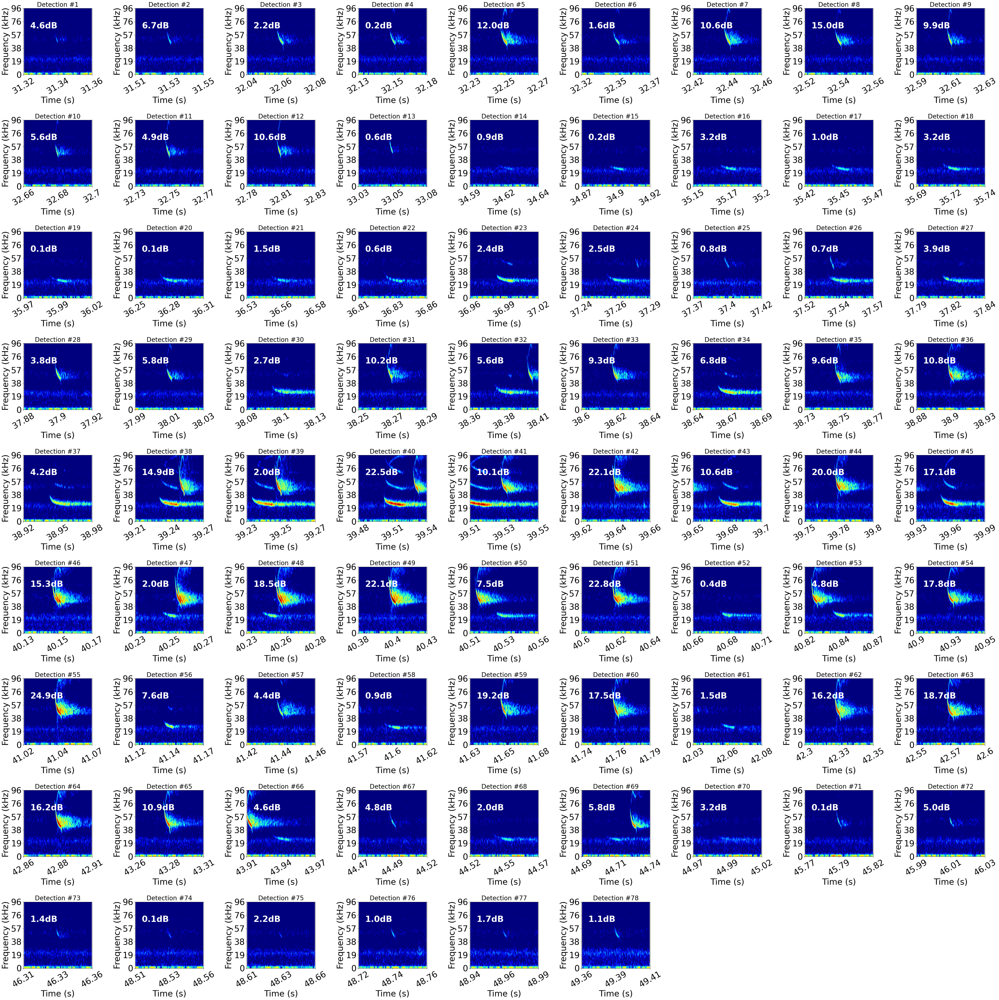

In [102]:
plt.figure(figsize=(6*np.ceil(len(plot_dets)**0.5), 6*np.ceil(len(plot_dets)**0.5)))
plt.rcParams.update({'font.size': 32})
for i, row in plot_dets.iterrows():
    start = row['start_time'] - 0.020
    call_dur = (row['end_time'] - row['start_time'])
    duration = call_dur + 0.040

    recorded_audio.seek(int(fs*row['start_time']))
    call_sig = recorded_audio.read(int(fs*call_dur))
    # band_limited_call_sig = bandpass_audio_signal(call_sig, fs, row['low_freq']-2000, row['high_freq']+2000)
    recorded_audio.seek(int(fs*(row['start_time'] - call_dur)))
    noise_sig = recorded_audio.read(int(fs*call_dur))
    # band_limited_noise_sig = bandpass_audio_signal(noise_sig, fs, row['low_freq']-2000, row['high_freq']+2000)
    snr = get_snr_from_band_limited_signal(call_sig, noise_sig)

    recorded_audio.seek(int(fs*start))
    audio_seg = recorded_audio.read(int(fs*duration))
    lower_dB = -50
    upper_dB = 0
    vmin = lower_dB # hide anything below lower_dB dB
    vmax = upper_dB # hide anything above upper_dB dB
    cmap = 'jet'
    nfft = 132

    plt.subplot(int(np.ceil(len(plot_dets)**0.5)), int(np.ceil(len(plot_dets)**0.5)), i+1)
    plt.title(f'Detection #{i+1}', fontsize=24)
    plt.specgram(audio_seg, NFFT=nfft, cmap=cmap, vmin=vmin, vmax=vmax)
    ax = plt.gca()
    plt.text(x=0.1, y=0.7, s=f'{round(snr,1)}dB', fontweight='bold', color='w', transform=ax.transAxes)
    plt.yticks(ticks=np.linspace(0, 1, 6), labels=np.linspace(0, fs/2000, 6).astype('int'))
    plot_xtype = 'float'
    if (duration > 60):
        plot_xtype = 'int'
    plt.xticks(ticks=np.linspace(0, duration*(fs/2), 3), 
               labels=np.round(np.linspace(start, start+duration, 3, dtype=plot_xtype), 2), rotation=30)
    plt.ylabel("Frequency (kHz)")
    plt.xlabel("Time (s)")

plt.tight_layout()
plt.show()

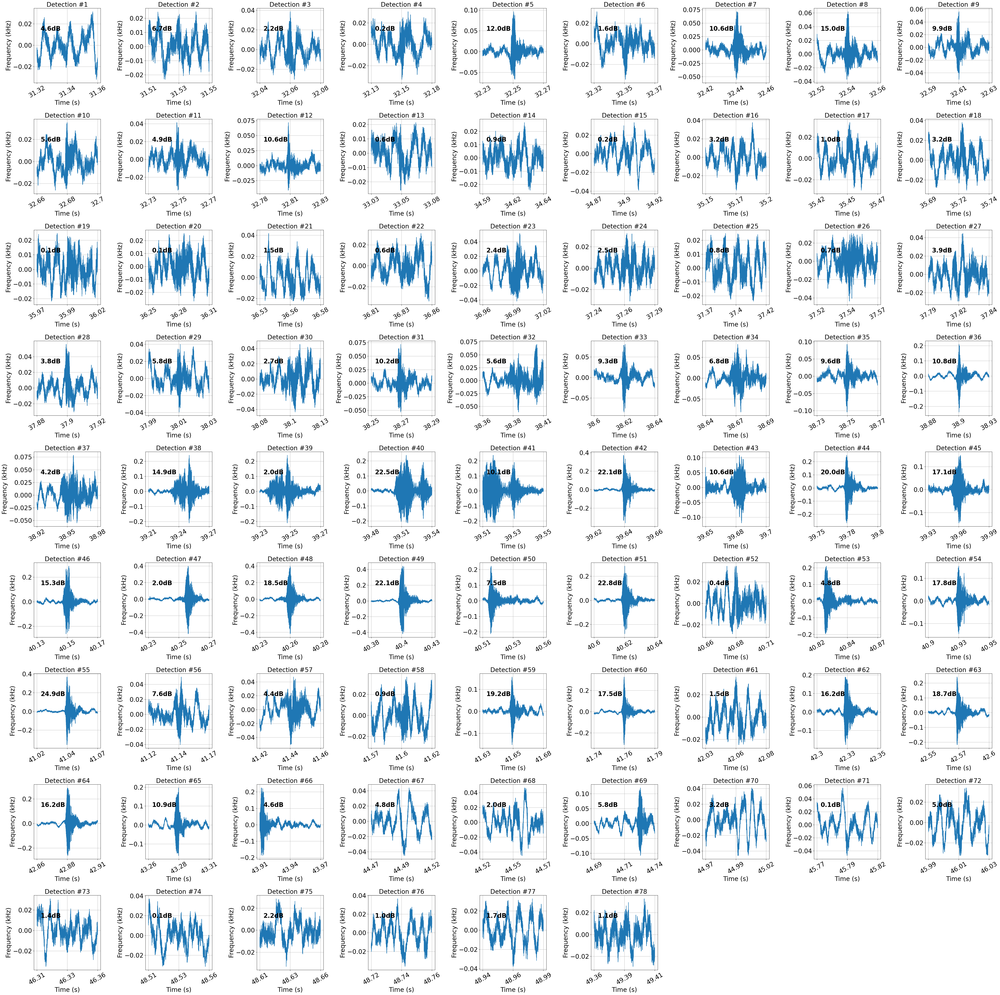

In [103]:
plt.figure(figsize=(6*np.ceil(len(plot_dets)**0.5), 6*np.ceil(len(plot_dets)**0.5)))
plt.rcParams.update({'font.size': 24})
for i, row in plot_dets.iterrows():
    start = row['start_time'] - 0.020
    call_dur = (row['end_time'] - row['start_time'])
    duration = call_dur + 0.040

    recorded_audio.seek(int(fs*row['start_time']))
    call_sig = recorded_audio.read(int(fs*call_dur))
    # band_limited_call_sig = bandpass_audio_signal(call_sig, fs, row['low_freq']-2000, row['high_freq']+2000)
    recorded_audio.seek(int(fs*(row['start_time'] - call_dur)))
    noise_sig = recorded_audio.read(int(fs*call_dur))
    # band_limited_noise_sig = bandpass_audio_signal(noise_sig, fs, row['low_freq']-2000, row['high_freq']+2000)
    snr = get_snr_from_band_limited_signal(call_sig, noise_sig)

    recorded_audio.seek(int(fs*start))
    audio_seg = recorded_audio.read(int(fs*duration))
    lower_dB = -58
    upper_dB = 0
    vmin = lower_dB # hide anything below lower_dB dB
    vmax = upper_dB # hide anything above upper_dB dB
    cmap = 'jet'
    nfft = 132

    plt.subplot(int(np.ceil(len(plot_dets)**0.5)), int(np.ceil(len(plot_dets)**0.5)), i+1)
    plt.title(f'Detection #{i+1}', fontsize=24)
    plt.plot(audio_seg)
    ax = plt.gca()
    plt.text(x=0.1, y=0.7, s=f'{round(snr,1)}dB', fontweight='bold', color='k', transform=ax.transAxes)
    plot_xtype = 'float'
    if (duration > 60):
        plot_xtype = 'int'
    plt.grid(which='both')
    plt.xticks(ticks=np.linspace(0, duration*(fs), 3), 
               labels=np.round(np.linspace(start, start+duration, 3, dtype=plot_xtype), 2), rotation=30)
    plt.ylabel("Frequency (kHz)")
    plt.xlabel("Time (s)")

plt.tight_layout()
plt.show()